### Capstone _ H&M Recommendation System _ Nooshin Mollazadeh

# EDA First Step

In this notebook we are going to have a brief insight about the Transaction dataset.

### Import needed libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path  
from matplotlib.pyplot import figure
import os
import seaborn as sns
import plotly.express as px
from os import listdir
from os.path import isfile, join
from termcolor import colored
from IPython.display import HTML, display, Image
import cv2


In [2]:
#path of images in my computer
images_dir = 'D:/images'


In [3]:
#I defined a function to see the colomn values distribution using plotly
#at first I used this for most of the distribution but it made my notebook huge so I just keep some of them
#in this function x is the column name and data is the dataframe name
def plot_distribution(x, data, title):
        fig = px.histogram(data, x = x,title = title)

        fig.show()

# Datasets:

We have 3 Tables:
- Transactions: Contains all the Transaction history
- Customers: Contains Customer data
- Articles: Contains products details

# Transaction:

- 't_dat' :  A unique identifier of every transaction date
- 'customer_id' :  A unique identifier of every customer (in customers table)
- 'article_id' :  A unique identifier of every article (in articles table)
- 'price' :  Price of purchase
- 'sales_channel_id' :  1 or 2 (1 for online and 2 for store)

In [4]:
#Reading the first csv file
transaction=pd.read_csv('C:/Users/molla/Capstone/transaction.csv')

In [5]:
#Looking at the head
transaction.head()

,t_dat,customer_id,article_id,price,sales_channel_id
0,2018-09-20,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,663713001,0.050831,2
1,2018-09-20,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,541518023,0.030492,2
2,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,505221004,0.015237,2
3,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,685687003,0.016932,2
4,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,685687004,0.016932,2


In [6]:
#Looking at the shape of table
transaction.shape

(28813419, 5)

There are 28,813,419 rows and 5 columnns in the dataset.

In [7]:
#Looking at the types of columns
transaction.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28813419 entries, 0 to 28813418
Data columns (total 5 columns):
 #   Column            Dtype  
---  ------            -----  
 0   t_dat             object 
 1   customer_id       object 
 2   article_id        int64  
 3   price             float64
 4   sales_channel_id  int64  
dtypes: float64(1), int64(2), object(2)
memory usage: 1.1+ GB


In [8]:
#getting the full description of variables in numeric columns
transaction.describe()

,article_id,price,sales_channel_id
count,2.881342e+07,2.881342e+07,2.881342e+07
mean,6.971462e+08,2.772868e-02,1.683251e+00
std,1.321538e+08,1.910103e-02,4.652085e-01
min,1.087750e+08,1.694915e-05,1.000000e+00
25%,6.331520e+08,1.567797e-02,1.000000e+00
50%,7.147900e+08,2.540678e-02,2.000000e+00
75%,7.871530e+08,3.388136e-02,2.000000e+00
max,9.562170e+08,5.915254e-01,2.000000e+00


In [9]:
#checking null values
transaction.isna().sum()

t_dat               0
customer_id         0
article_id          0
price               0
sales_channel_id    0
dtype: int64

There is no null values in the transaction table.

In [10]:
#checking the duplicates
transaction.duplicated().sum()

0

There is no duplicated rows in the dataset.

In [11]:
#how many different dates we have for the transactions
transaction['t_dat'].value_counts()

2019-09-28    176904
2019-11-29    144908
2020-04-11    143534
2018-09-29    131218
2018-11-23    130931
               ...  
2018-09-22     16276
2019-01-01     15792
2018-12-25     13061
2019-12-25     12055
2020-01-01     11194
Name: t_dat, Length: 734, dtype: int64

The transactions took place in 734 different dates.

In [12]:
print (transaction.t_dat.min())
print(transaction.t_dat.max())

2018-09-20
2020-09-22


The transactions took place between 2018-09-20 until 2020-09-22 in 734 different days.

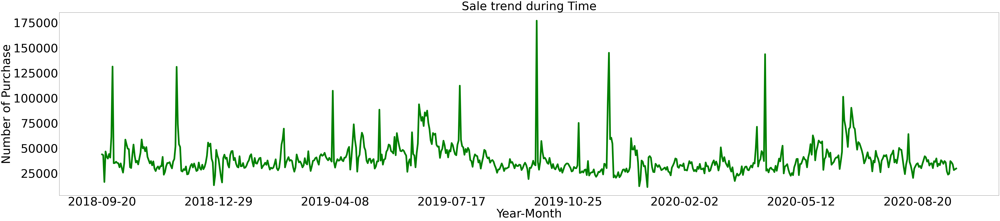

In [13]:
#Total number of transaction in each day

#Figuresize
plt.figure(figsize=(100, 20))

#Plotting number of transactions during dates
t_date_plot=transaction.groupby(['t_dat'])['t_dat'].count()
t_date_plot.plot(kind='line',linewidth=10,color='green')

#fontsize of X and yticks
plt.xticks(fontsize = 70)
plt.yticks(fontsize=70)

#X and Y label
plt.xlabel('Year-Month', fontdict={'fontsize':70})
plt.ylabel('Number of Purchase', fontdict={'fontsize':70})

#title
plt.title('Sale trend during Time', fontdict={'fontsize':70})
#show thee figure
plt.show()

### Figure 1
This figure shows the trend for number of purchasing during the time period. We can see fluctuation during the time. 

In [14]:
t_date_plot.to_csv('Number_of_Sales_Trend.csv')

### Creating a new column for YearMonth Period

In [15]:
#Change the date column type to datetime for furthye analyze
transaction['t_dat']=pd.to_datetime(transaction['t_dat'])

In [16]:
#I created a new column for year month to look more closely in each year-month priod
transaction['yearmonth']=transaction['t_dat'].dt.to_period('M')

In [17]:
#Sanity check
transaction.head()

,t_dat,customer_id,article_id,price,sales_channel_id,yearmonth
0,2018-09-20,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,663713001,0.050831,2,2018-09
1,2018-09-20,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,541518023,0.030492,2,2018-09
2,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,505221004,0.015237,2,2018-09
3,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,685687003,0.016932,2,2018-09
4,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,685687004,0.016932,2,2018-09


In [18]:
#Creating a new table for transaction yearmonth period
#We can see number of purchases in each year month
t_date_count=transaction.groupby(['yearmonth']).size().rename('NofT').reset_index()
t_date_count

,yearmonth,NofT
0,2018-09,542680
1,2018-10,1271899
2,2018-11,1158527
3,2018-12,1046956
4,2019-01,1127415
5,2019-02,1036731
6,2019-03,1150798
7,2019-04,1332200
8,2019-05,1413315
9,2019-06,1722723


In [19]:
t_date_count.to_csv('Sales_yearmonth.csv')

In [20]:
#seeing the info about t_date_count
t_date_count.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25 entries, 0 to 24
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype    
---  ------     --------------  -----    
 0   yearmonth  25 non-null     period[M]
 1   NofT       25 non-null     int64    
dtypes: int64(1), period[M](1)
memory usage: 528.0 bytes


We have 25 year month in the transaction data set.

# Plotting Number of Sales during Year-Month¶

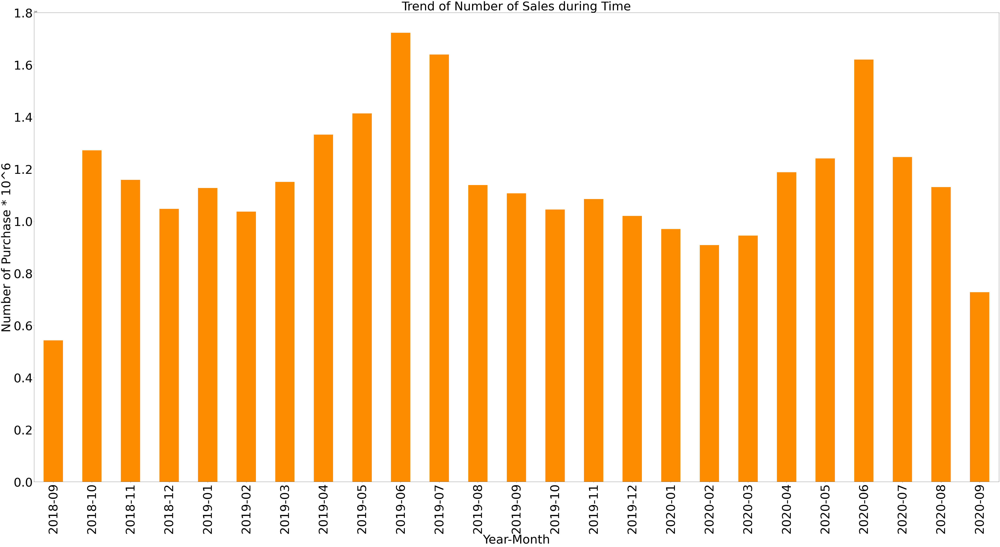

In [21]:
#Total number of transaction in each day

#Figuresize
plt.figure(figsize=(100, 50))

#Plotting number of transactions during dates
ax= transaction.groupby(['yearmonth'])['yearmonth'].count().plot(kind='bar',color='darkorange', ylim=(0,1800000))
#t_date_plot.plot(kind='line',linewidth=15, color='darkorange')
ax.plot(kind='bar',color='darkorange', ylim=(0,1800000))
#ax.ticklabel_format(useOffset=False,style='plain')

#fontsize of X and yticks
plt.xticks(fontsize = 70)
#plt.rc('xtick', labelsize=70)
plt.yticks(fontsize=70)

#X and Y label
plt.xlabel('Year-Month', fontdict={'fontsize':70})

#ylabel
plt.ylabel('Number of Purchase * 10^6', fontdict={'fontsize':70})

#title
plt.title('Trend of Number of Sales during Time', fontdict={'fontsize':70})


plt.show()

### Figure2:
In the June 2019 we have the highest total number of transactions in month. June 2020 is also the second month with highest purchases amount. We see the lowest number of purchases during the September 2018 because it is not the full month in the dataset.(also the last month) So apart from the months that we do not have the full months data in other period the lowest amount of purchases took place during February 2020.

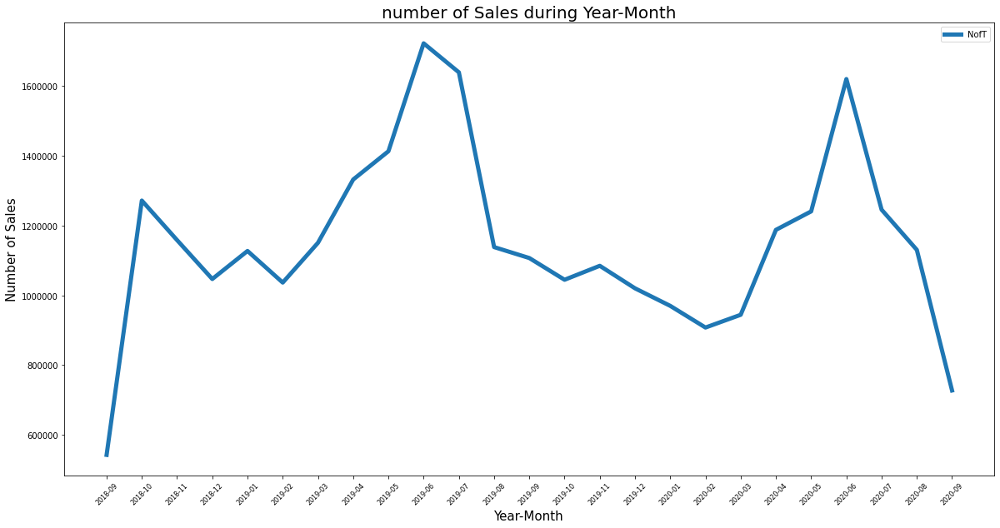

In [22]:
#plotting from t_date_count dataframe which has number of sales during yearmonth
t_date_count.plot(figsize=(20,10),linewidth=5)

plt.ticklabel_format(style='plain', axis='y')


#ticks rotation and size
plt.xticks(rotation=45)


plt.xticks(fontsize = 8,ticks = t_date_count.index,labels = t_date_count['yearmonth'])


plt.yticks(fontsize=10)

#naming the plot
plt.title('number of Sales during Year-Month', fontdict={'fontsize':20})

#naming the labels
plt.xlabel('Year-Month', fontdict={'fontsize':15})
plt.ylabel('Number of Sales', fontdict={'fontsize':15})
plt.show()

# Figure 3

The same as figure 2 we can see the amount of sales but with the line plot it is easier to look at the trend and how sale is working during time.

## Plotting Total Sales Revenue During Year-Month

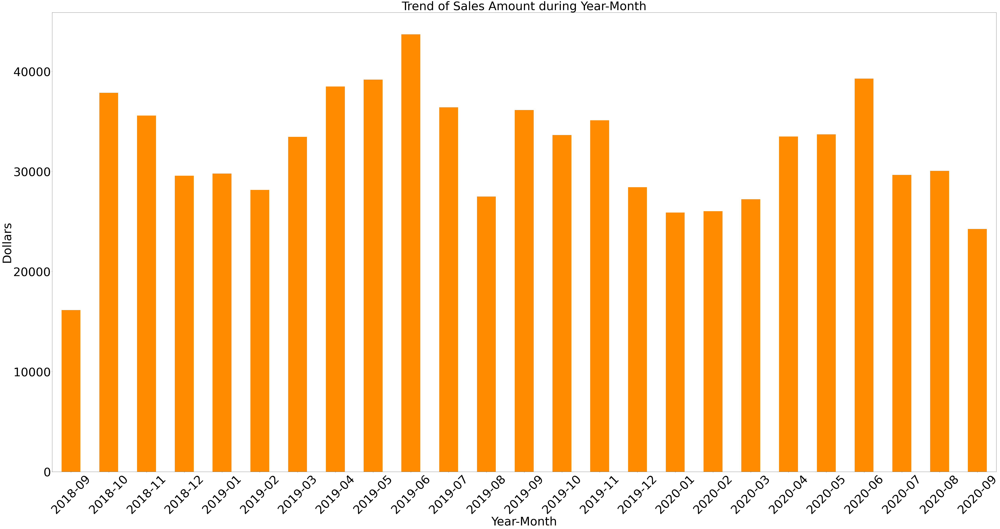

In [23]:
#To focus on Sales amount we can sum the prices of transactions for each period of time
plt.figure(figsize=(100, 50))

#group by each period and sum the price for each group then plot a bar chart
t_date_sale=transaction.groupby(['yearmonth'])['price'].sum()
t_date_sale.plot(kind='bar',color='darkorange' )

#ticks rotation and size
plt.xticks(rotation=45)
plt.xticks(fontsize = 70)
plt.yticks(fontsize=70)

#naming the plot
plt.title('Trend of Sales Amount during Year-Month', fontdict={'fontsize':70})

#naming the labels
plt.xlabel('Year-Month', fontdict={'fontsize':70})
plt.ylabel('Dollars', fontdict={'fontsize':70})

#show
plt.show()

# Figure 4:
According to figure 4 we see the trend of sales amount during time. The price is not the original value because of privacy reasons of the h&m company. So we jast can see the trend and it is good for comparing each of them. For example In June 2019 we see the highest amount of sales in dollar and we see fluctuations during the whole period which matches with the Figure 2 that showed the highest number of sales during June 2019.

### Looking to the customers

In [24]:
#by grouping the customers and counting each group we can get a dataframe with customer ids and number of 
#purchases for ech of them
t_by_customer = transaction.groupby('customer_id', as_index=False).size()
t_by_customer

,customer_id,size
0,00000dbacae5abe5e23885899a1fa44253a17956c6d1c3...,19
1,0000423b00ade91418cceaf3b26c6af3dd342b51fd051e...,78
2,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,15
3,00005ca1c9ed5f5146b52ac8639a40ca9d57aeff4d1bd2...,2
4,00006413d8573cd20ed7128e53b7b13819fe5cfc2d801f...,13
...,...,...
1362276,ffffbbf78b6eaac697a8a5dfbfd2bfa8113ee5b403e474...,45
1362277,ffffcd5046a6143d29a04fb8c424ce494a76e5cdf4fab5...,82
1362278,ffffcf35913a0bee60e8741cb2b4e78b8a98ee5ff2e6a1...,43
1362279,ffffd7744cebcf3aca44ae7049d2a94b87074c3d4ffe38...,7


There is 1,362,281 different customer ids in the transaction table

In [25]:
#sorting from highest size to the lowest
t_by_customer=t_by_customer.sort_values(['size'],ascending=False)

In [26]:
# get the 100 customers who bought more
Customer_100=t_by_customer.head(100)
Customer_100

,customer_id,size
1011710,be1981ab818cf4ef6765b2ecaea7a2cbf14ccd6e8a7ee9...,1641
962395,b4db5e5259234574edfff958e170fe3a5e13b6f146752c...,1321
885174,a65f77281a528bf5c1e9f270141d601d116e1df33bf9df...,1304
391840,49beaacac0c7801c2ce2d189efe525fe80b5d37e46ed05...,1233
1090960,cd04ec2726dd58a8c753e0d6423e57716fd9ebcf2f14ed...,1217
...,...,...
947170,b1f6279bf42c22b29e1f97bbcc3163bd5128cfd4b8a2c0...,602
1140826,d656aff527a119a1c1f23e09281ad13305e11584b977b4...,601
777096,921be2c5d4385468f61e045b09f78f2349aec418425e79...,601
570903,6b47a05d1c6914c87331c2ec893dff5e5b071dcdc15427...,601


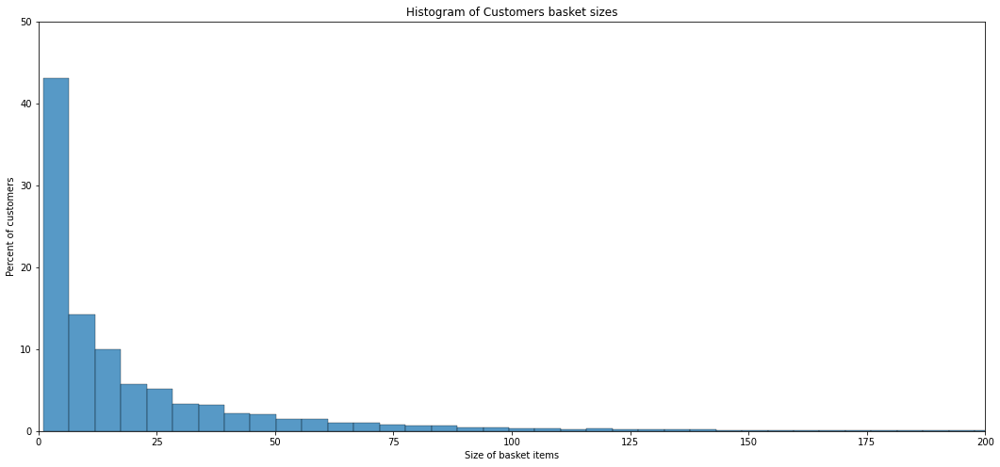

In [27]:
#Checking customers different basket sizes histogram

#figsize
plt.figure(figsize=(18,8))

#plotting a histogram to see the distribution
sns.histplot(data=t_by_customer, x='size', bins=300, stat='percent')

#defining limit for x and y axes
plt.xlim(0,200)
plt.ylim(0,50)

#title
plt.title('Histogram of Customers basket sizes')

#x,y label
plt.xlabel('Size of basket items')
plt.ylabel('Percent of customers')

#x,y ticks
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)

#show the plot
plt.show()

### Figure 5:

By looking at the histogram we can say that the majority of customers have basket sizes less than 100.

In [28]:
#plot distribution using plotly


fig = px.histogram(
        t_by_customer, 
        x = 'size',
        width = 700,
        height = 500,
        title = 'Customer Basket Size Distribution'
        )

fig.show()

## Figure 6:
The figure 4 displays the distribution of number of customers with different basket sizes. We can see that the majority of customers have basket sizes below than 300.

## Figure 7:
Here also the most number of people have smaller basket sizes.

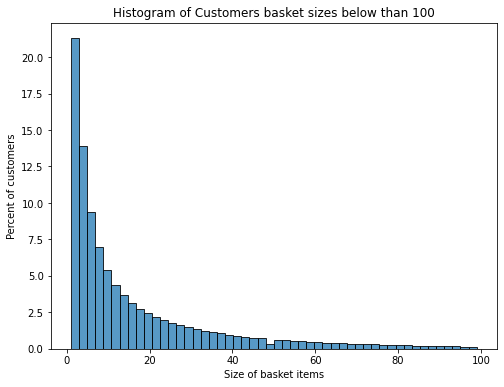

In [29]:
#Applying the condition of basket size for basket sizes below than 300
t_by_customer_50tr = t_by_customer[t_by_customer['size'] < 100]

plt.figure(figsize=(8,6))

sns.histplot(data=t_by_customer_50tr, x='size', bins=50, stat="percent")


plt.title('Histogram of Customers basket sizes below than 100')

plt.xlabel('Size of basket items')
plt.ylabel('Percent of customers')

plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)

plt.show()

## Figure 7:

Figure 7 shows the customer's basket size distribution for the basket sizes less than 100 during this period. The x axis shows the percentage of customers. So from the figure we can say that the majority of customers have smaller basket sizes. 

***

# Sales channel:

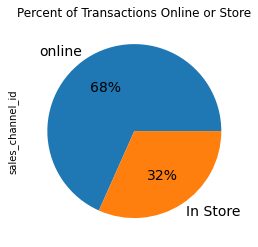

In [30]:
#Sale channels different categories and numbers through each of them
sale_channel = transaction['sales_channel_id'].value_counts()

#plot a pie chart with online and in store label
sale_channel.plot.pie(labels=['online','In Store'],autopct='%1.0f%%',textprops={'fontsize': 14})

#title
plt.title('Percent of Transactions Online or Store')

plt.show()

## Figure 8:
We see that 68 percent of transaction took place through website and 32 % of them was purchased in store. 68% of people shows for online sales channel shows people like to buy online from h&m brand.

***

## Article ID

Article ids refer to different products. First we will find how many items have been bought during the transactions period.

In [31]:
#categorizing the number of sales for each article
article_sale=transaction.groupby(['article_id']).size().rename('NofSales').reset_index()

article_sale=article_sale.sort_values(['NofSales'],ascending=False)

In [32]:
article_sale.shape

(104547, 2)

Total number of 104,547 different products have been purchased by customers during this period of time.

## Top 10 most purchased articles:

In [33]:
# 10 most popular products
top_10_article=article_sale.head(10)
top_10_article

,article_id,NofSales
53832,706016001,42672
53833,706016002,30862
1711,372860001,29337
24808,610776002,25234
70124,759871002,23799
1712,372860002,22472
3706,464297007,21782
2233,399223001,19604
58427,720125001,18975
24807,610776001,18777


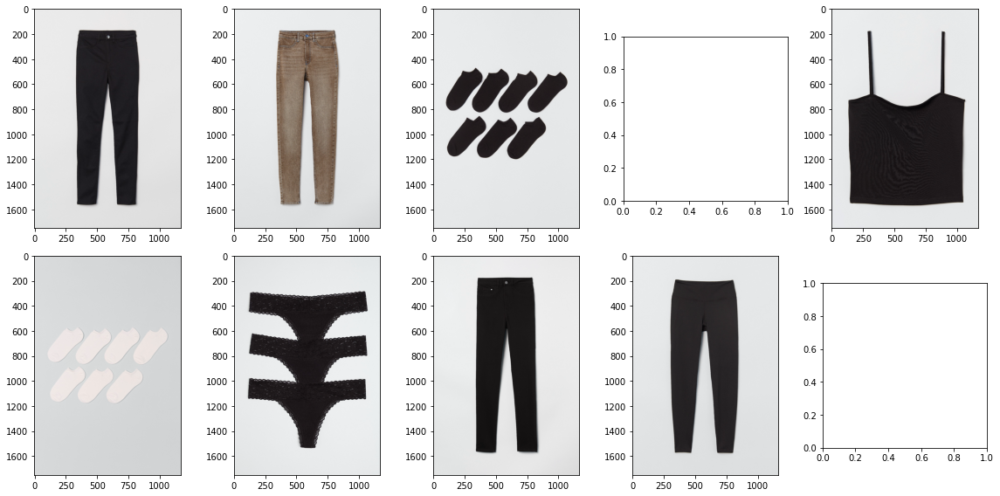

In [34]:
#We will define a for loop which shows the images from the imapge location path

figure, ax = plt.subplots(nrows=2,ncols=5,figsize=(16,8))
for iid, im_id in enumerate(top_10_article['article_id']):

    #that's how the image path is in my directory
        image_path = f'{images_dir}/0{str(im_id)[:2]}/0{im_id}.jpg'
        
        #using cv2 to read the image
        image=cv2.imread(image_path)
        
        try:
            #flatten it and then show it
            ax.ravel()[iid].imshow(image)
            
        except:
            continue;
            
#first plotting the layout of images            
plt.tight_layout()

#showing the whole set of images
plt.show()

#I first tried the first 8 lines of the code 

We see four of the popular items are trousers. Later we will figure out trousers group is the most favorite product group.

* Two items doesn't have images in the dataset.

We can also look into the items which bring  company higher amount of revenue during this time.

## Top 10 most revenue making articles:

In [35]:
#group by the different article ids and sum the price for each article id
article_sale_revenue=transaction.groupby(['article_id'])['price'].agg('sum').rename('TotalRevenue').reset_index()
article_sale_revenue=article_sale_revenue.sort_values(['TotalRevenue'],ascending=False)

In [36]:
#Top 10 products with highest revenue
Top_10_revenue_article=article_sale_revenue.head(10)
Top_10_revenue_article

,article_id,TotalRevenue
53832,706016001,1382.011831
53833,706016002,999.628169
15980,568601006,814.209271
3087,448509014,651.939864
58427,720125001,615.029305
2233,399223001,607.259339
53834,706016003,606.382220
14232,562245046,569.206915
67435,751471001,510.226305
39502,661794001,488.090712


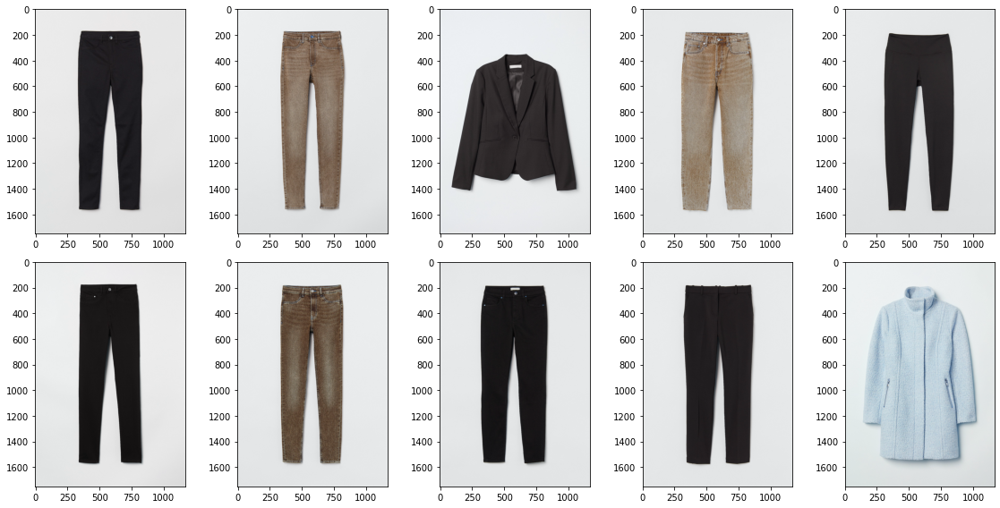

In [37]:
#We will define a for loop which shows the images from the imapge location path

figure, ax = plt.subplots(nrows=2,ncols=5,figsize=(16,8))
for iid, im_id in enumerate(Top_10_revenue_article['article_id']):

    #that's how the image path is in my directory
        image_path = f'{images_dir}/0{str(im_id)[:2]}/0{im_id}.jpg'
        
        #using cv2 to read the image
        image=cv2.imread(image_path)
        
        try:
            #flatten it and then show it
            ax.ravel()[iid].imshow(image)
            
        except:
            continue;
            
#first plotting the layout of images            
plt.tight_layout()

#showing the whole set of images
plt.show()

#I first tried the first 8 lines of the code 

***

 8 articles out of ten top revenue making articles are trousers.

## Price:

Because of h&m privacy reasons the prices in the datasets has been scaled.

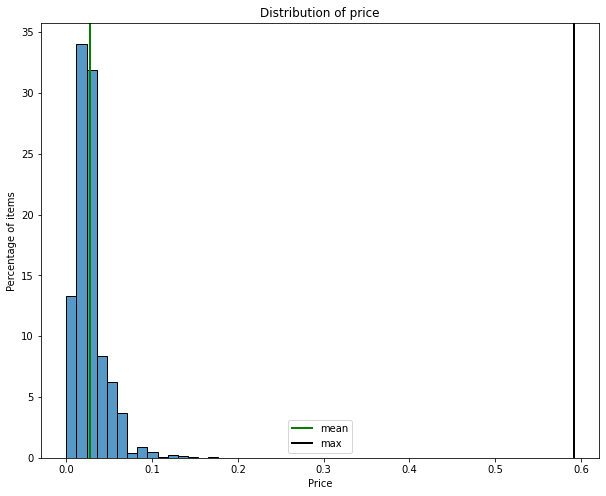

Mean price of articles is:0.02772867989220048
Maximum price of articles is:0.5915254237288136
Minimum price of articles is:1.694915254237288e-05


In [38]:
#figsize
plt.figure(figsize=(10,8))

#plotting a histogram to see the distribution
ax = sns.histplot(data=transaction, x='price', bins=50, stat="percent")

#ax.set_xlabel('Distribution of the price')

#calculating min,max and mean
mean = transaction['price'].mean()
Max=transaction['price'].max()
Min=transaction['price'].min()

#plotting vlines for mean and max
plt.axvline(mean, color='green', linewidth=2 , label='mean')
plt.axvline(Max, color='k', linewidth=2, label= 'max')


#title
plt.title('Distribution of price')

#xlabel
plt.xlabel('Price')
plt.ylabel('Percentage of items')


plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)

#legend is for the vlines
plt.legend()
plt.show()


print(f'Mean price of articles is:{mean}')
print(f'Maximum price of articles is:{Max}')
print(f'Minimum price of articles is:{Min}')

### Figure 9:

From the figure we can see that the majority of items have a price less than 0.1 while the maximum is about 0.6 the average price of items is 0.027 which is about 22 times more expencive.

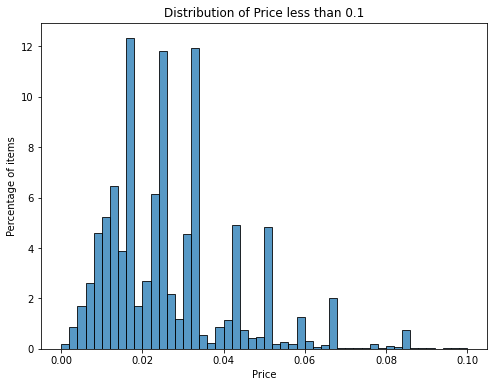

In [39]:
#Let's have a closer look to the distribution of prices below than 0.1
plt.figure(figsize=(8,6))

#adding a condition to just show the prices less than 0.1
sns.histplot(data=transaction[transaction['price']<0.1], x='price', bins=50, stat="percent")


plt.title('Distribution of Price less than 0.1')

plt.xlabel('Price')
plt.ylabel('Percentage of items')

plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)

plt.show()

### Figure 10:

Still we see that the majority of items has a price about 0.02.(mean price)

With using box plot we can see the distribution as well as the outliers.

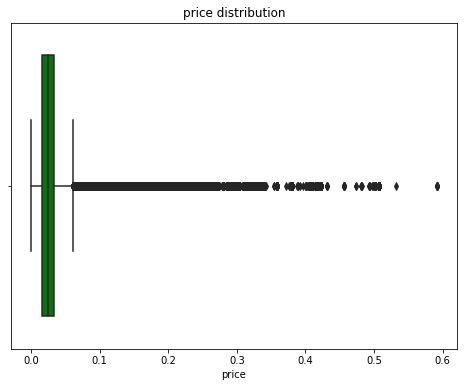

In [40]:
plt.figure(figsize=(8,6))

#boxplot from seaborn
sns.boxplot(data=transaction, x='price' , color='green')

plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)

plt.title('price distribution')

plt.show()

### Figure 11:

It shows many outliers in the price distribution.

***

***